# Prerequisites

In [1]:
import sys

sys.path.append("..")

In [2]:
import argparse
import os
import time

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import torch
from torchvision.models import resnet18, resnet50
from tqdm import tqdm

from dataset import get_dloader, normalize_inv
from util import eval_step, get_obj_score, get_performance, get_saliency

C:\Users\runes\.conda\envs\context\Lib\site-packages\torchvision\transforms\v2\_deprecated.py:41: UserWarning: The transform `ToTensor()` is deprecated and will be removed in a future release. Instead, please use `v2.Compose([v2.ToImage(), v2.ToDtype(torch.float32, scale=True)])`.
  warnings.warn(


In [3]:
from matplotlib.colors import LinearSegmentedColormap

my_gradient = LinearSegmentedColormap.from_list(
    "my_gradient",
    (
        # Edit this gradient at https://eltos.github.io/gradient/#4C71FF-0025B3-000000-C7030D-FC4A53
        (0.000, (0.298, 0.443, 1.000)),
        (0.250, (0.000, 0.145, 0.702)),
        (0.500, (0.000, 0.000, 0.000)),
        (0.750, (0.780, 0.012, 0.051)),
        (1.000, (0.988, 0.290, 0.325)),
    ),
)

In [4]:
data_dir = "../data"
class_legend = ("Siberian Husky", "Grey Wolf")
model_types = {"r18": "ResNet 18", "r50": "Resnet 50"}

device = "cuda" if torch.cuda.is_available() else "cpu"

print(f"Using device: {device}")


def get_model(model_type, device="cpu", seed=191510):
    torch.manual_seed(seed)
    if model_type == "r18":
        model = resnet18(weights=None)
    elif model_type == "r50":
        model = resnet50(weights=None)
    model.fc = torch.nn.Linear(
        in_features=model.fc.in_features, out_features=len(class_legend), bias=True
    )
    model.to(device)
    return model

Using device: cuda


# Data

In [5]:
valloader = get_dloader("val", batch_size=1, data_dir=data_dir)

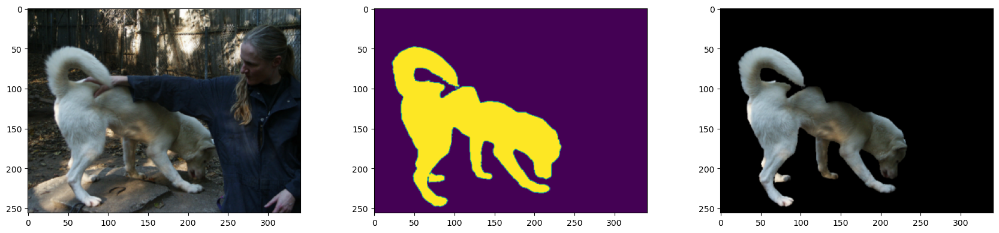

In [6]:
imgs, labels, masks = next(iter(valloader))
im, label, mask = imgs[0], labels[0], masks[0]
im = normalize_inv(im)

fig, (ax0, ax1, ax2) = plt.subplots(1, 3, figsize=(18, 4), tight_layout=True)
ax0.imshow(np.moveaxis(im.numpy(), 0, -1))
ax1.imshow(np.moveaxis(mask.numpy(), 0, -1))
ax2.imshow(np.moveaxis((im * mask).numpy(), 0, -1));

# Load model

In [7]:
model_type = "r18"

# Get models
model_a = get_model(model_type, device=device)
model_b = get_model(model_type, device=device)

In [8]:
cpt_a = '../models/hw-checkpoints/run-20240307-130455/a/r18_e95.cpt'
cpt_b = '../models/hw-checkpoints/run-20240307-130455/b/r18_e75.cpt'

In [9]:
for cpt, model in ((cpt_a, model_a), (cpt_b, model_b)):
    checkpoint = torch.load(cpt)
    model.load_state_dict(checkpoint['model_state_dict'])

In [10]:
model_a.eval()
model_b.eval();

# Saliency maps

In [11]:
iter_valloader = iter(valloader)

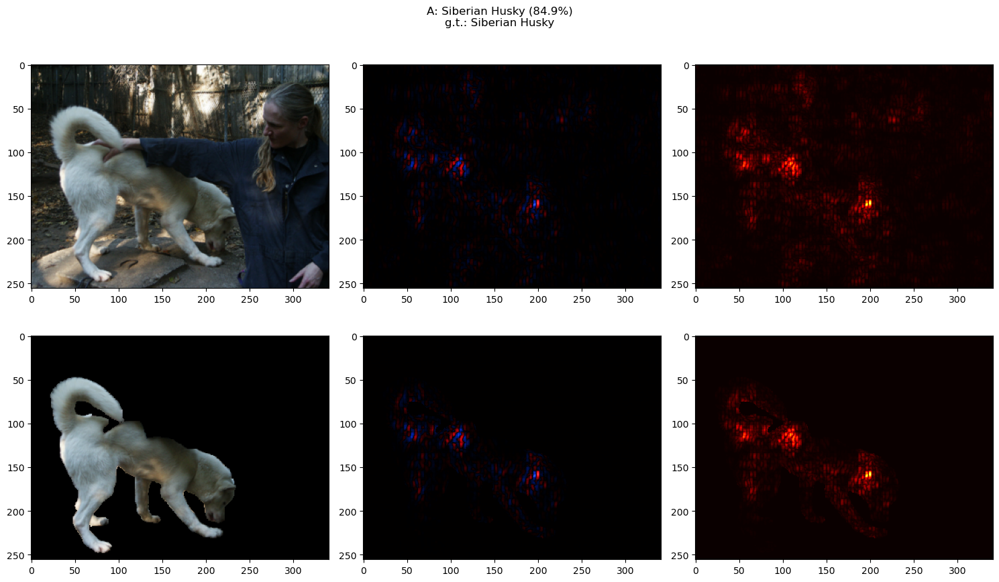

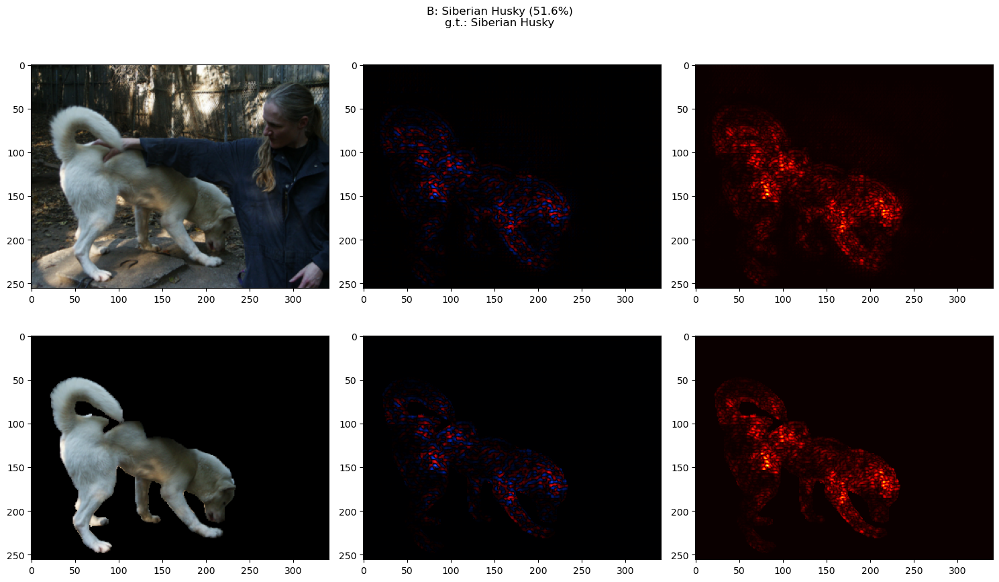

In [12]:
imgs, labels, masks = next(iter_valloader)
im, label, mask = imgs[0], labels[0], masks[0]
im = normalize_inv(im)

slc_a, score_a, indices_a, out_a = get_saliency(model_a, imgs, device=device)
slc_b, score_b, indices_b, out_b = get_saliency(model_b, imgs * masks, device=device)

conf_a = torch.softmax(out_a, 1)[0, indices_a]
conf_b = torch.softmax(out_b, 1)[0, indices_b]

mask = masks[0, 0].numpy().astype(bool)

for name, slc, conf, idx in zip(('A', 'B'), (slc_a, slc_b), (conf_a.item(), conf_b.item()), (indices_a.item(), indices_b.item())):
    fig, ((ax00, ax01, ax02), (ax10, ax11, ax12)) = plt.subplots(2, 3, figsize=(15, 9), tight_layout=True)
    fig.suptitle(f'{name}: {class_legend[idx]} ({conf:.1%})\ng.t.: {class_legend[label.item()]}')
    ax00.imshow(np.moveaxis(im.numpy(), 0, -1))
    ax01.imshow((slc + 1) / 2, cmap=my_gradient, vmin=0, vmax=1)
    ax02.imshow(np.abs(slc), cmap='hot', vmin=0, vmax=1)
    
    ax10.imshow(np.moveaxis((im * mask).numpy(), 0, -1))
    ax11.imshow(((slc * mask.astype(float) + 1) / 2) , cmap=my_gradient, vmin=0, vmax=1)
    ax12.imshow(np.abs(slc) * mask.astype(float), cmap='hot', vmin=0, vmax=1)
    plt.show()

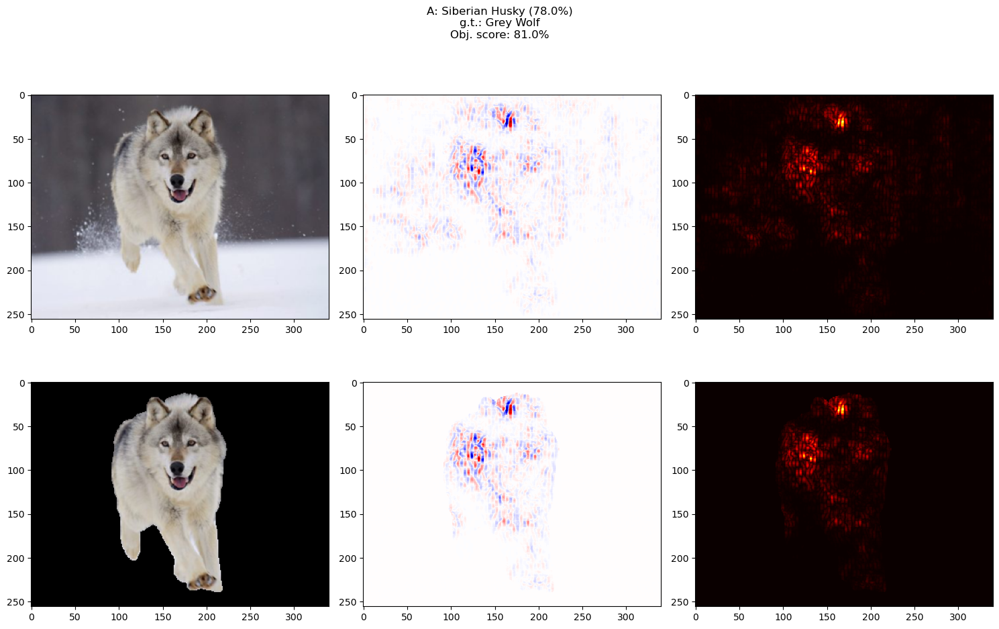

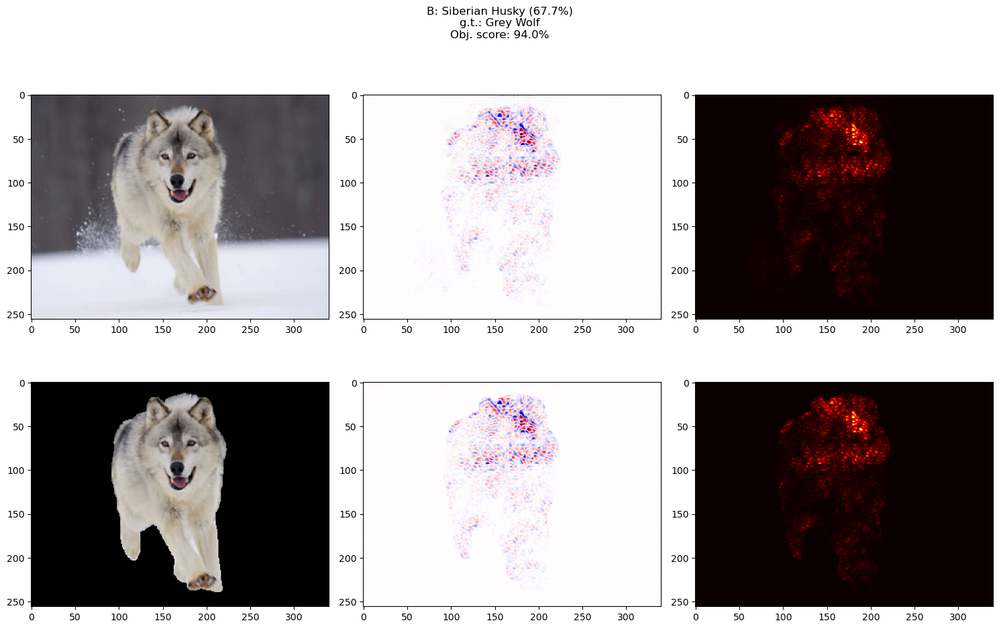

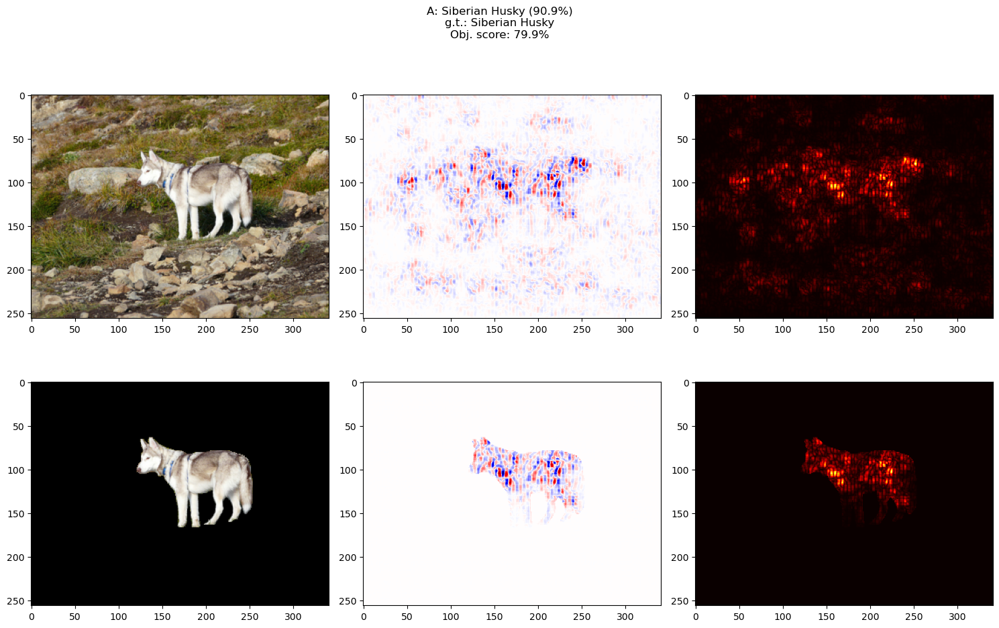

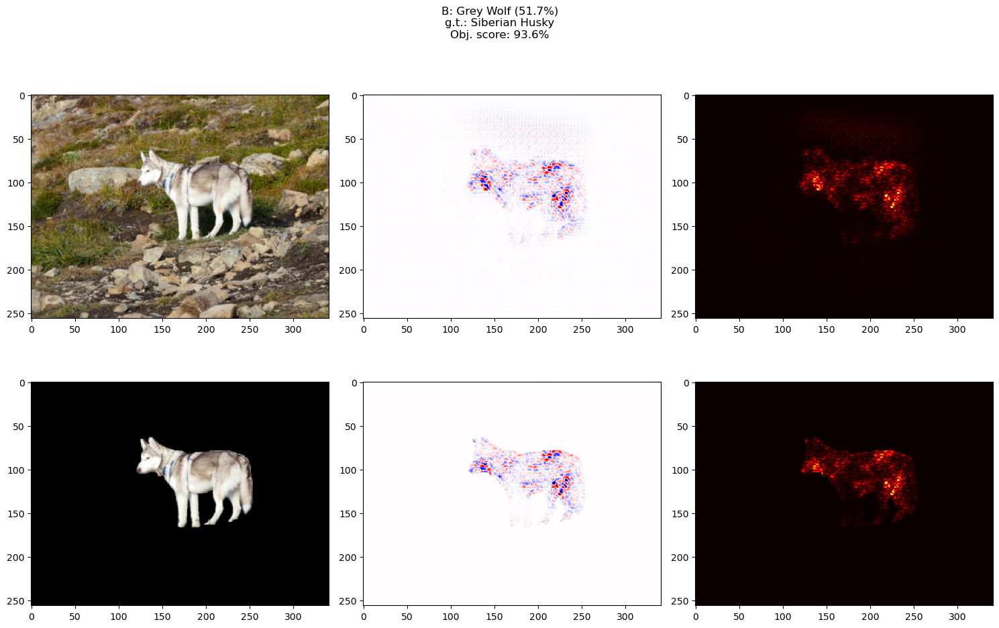

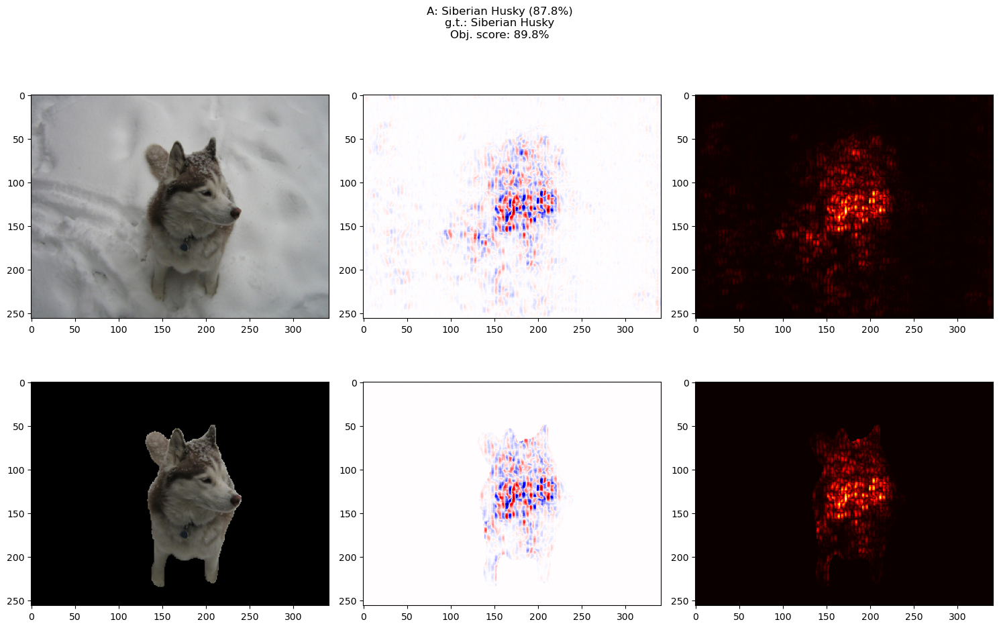

...

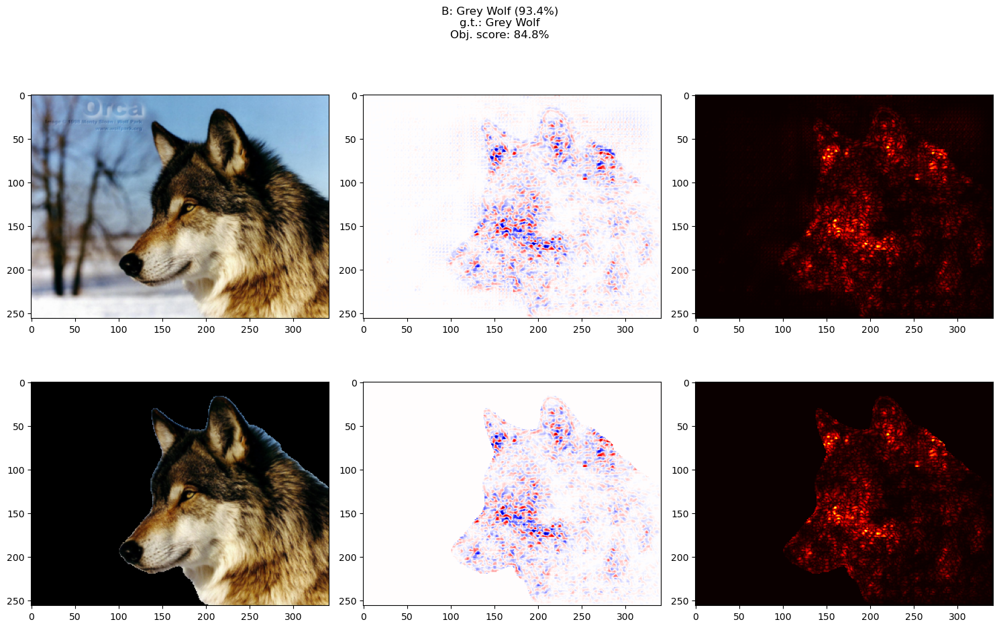

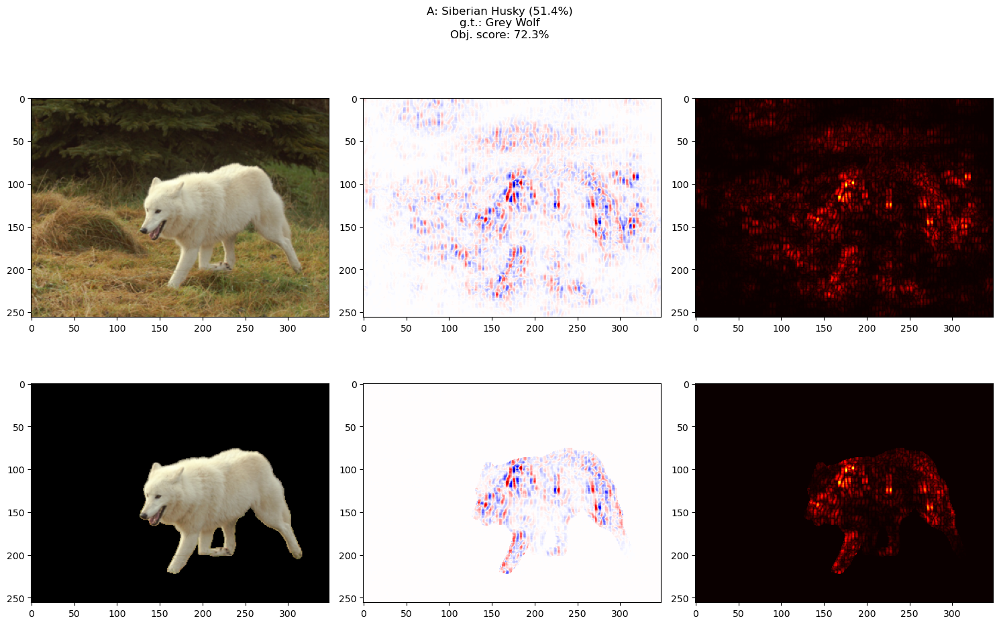

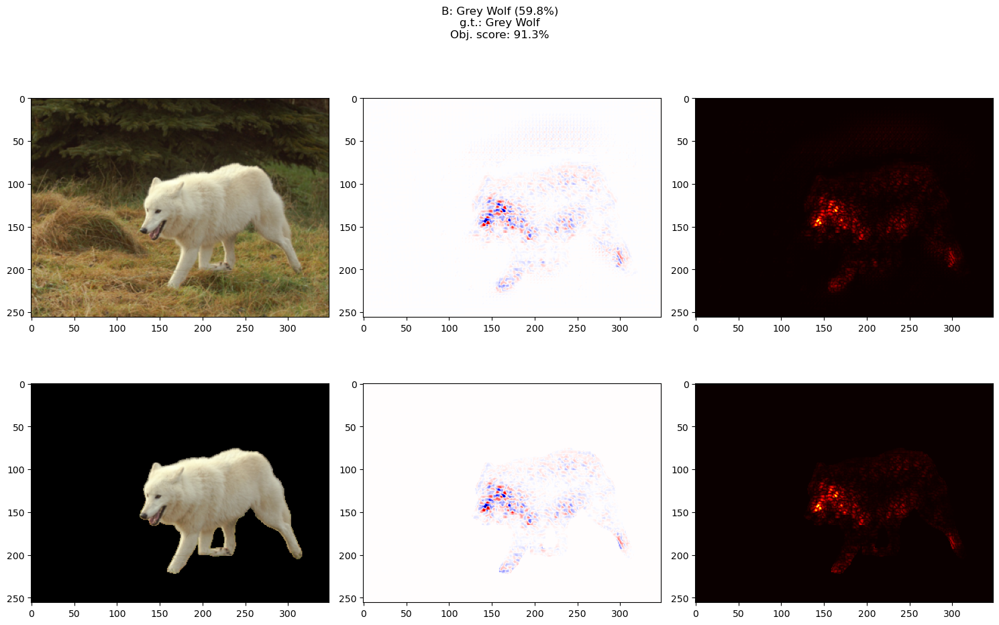

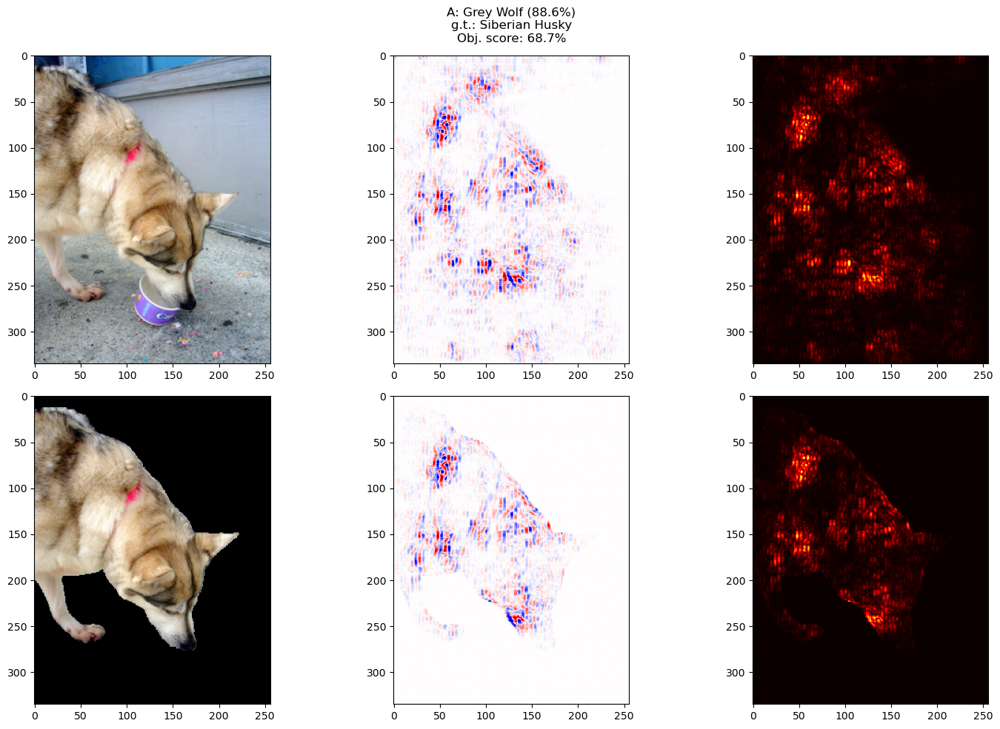

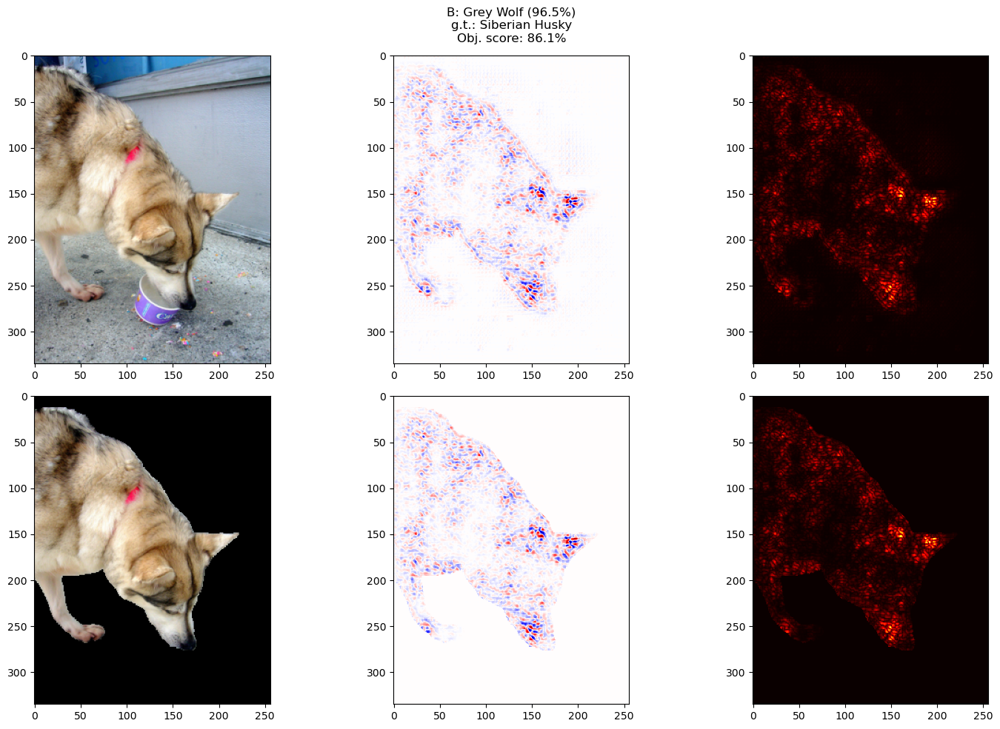

In [27]:
for imgs, labels, masks in valloader:
    im, label, mask = imgs[0], labels[0], masks[0]
    im = normalize_inv(im)
    
    slc_a, score_a, indices_a, out_a = get_saliency(model_a, imgs, device=device)
    slc_b, score_b, indices_b, out_b = get_saliency(model_b, imgs * masks, device=device)

    if indices_a.item() == label.item() and indices_b.item() == label.item():
        continue

    obj_score_a = get_obj_score(slc_a, masks)
    obj_score_b = get_obj_score(slc_b, masks)
    
    conf_a = torch.softmax(out_a, 1)[0, indices_a]
    conf_b = torch.softmax(out_b, 1)[0, indices_b]
    
    mask = masks[0, 0].numpy().astype(bool)
    
    for name, slc, conf, idx, obj_score in zip(('A', 'B'), (slc_a, slc_b), (conf_a.item(), conf_b.item()), (indices_a.item(), indices_b.item()), (obj_score_a, obj_score_b)):
        fig, ((ax00, ax01, ax02), (ax10, ax11, ax12)) = plt.subplots(2, 3, figsize=(15, 10), tight_layout=True)
        fig.suptitle(f'{name}: {class_legend[idx]} ({conf:.1%})\ng.t.: {class_legend[label.item()]}\nObj. score: {obj_score:.1%}')
        ax00.imshow(np.moveaxis(im.numpy(), 0, -1))
        ax01.imshow((slc + 1) / 2, cmap='seismic', vmin=0, vmax=1)
        ax02.imshow(np.abs(slc), cmap='hot', vmin=0, vmax=1)
        
        ax10.imshow(np.moveaxis((im * mask).numpy(), 0, -1))
        ax11.imshow(((slc * mask.astype(float) + 1) / 2) , cmap='seismic', vmin=0, vmax=1)
        ax12.imshow(np.abs(slc) * mask.astype(float), cmap='hot', vmin=0, vmax=1)
        
        plt.show()